In [1]:
using DataFrames
using Gadfly
using Compose
set_default_plot_size(30cm, 12cm)

# apo

## minimization

In [2]:
dir_apo_min="/home/german/labo/17/cph_obp/run/apo/mhe/m"
apo_min_Etot = readdlm("$dir_apo_min/outputs/Etot_min");
apo_mmin_Etot = readdlm("$dir_apo_min/outputs/Etot_mmin");
df_apo_MIN_Etot = DataFrame(E=[apo_min_Etot[:, 2]; apo_mmin_Etot[:, 2]],
NSTEP=[apo_min_Etot[:, 1]; apo_mmin_Etot[:, 1] .+ 500.0]);

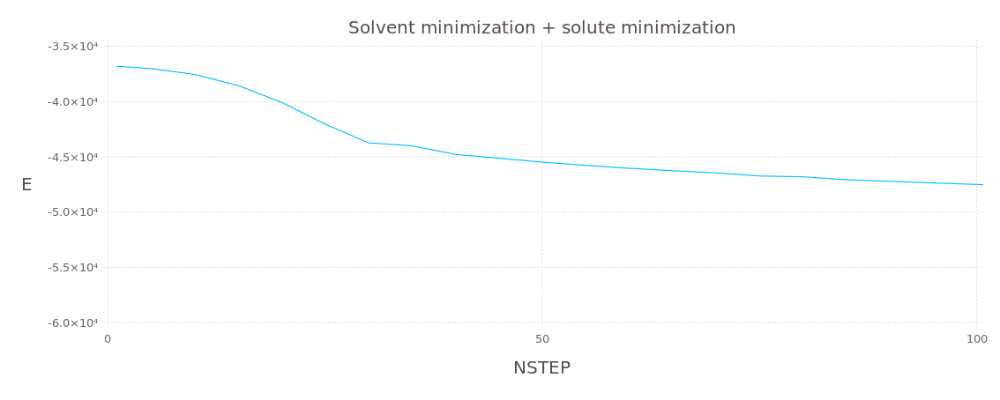

In [3]:
plot(df_apo_MIN_Etot, Geom.line, x="NSTEP", y="E",
Coord.Cartesian(xmin=0, xmax=100),
Guide.title("Solvent minimization + solute minimization"),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt, key_title_font_size = 30pt))

## heat

In [4]:
# Energies
dir_apo_hea="/home/german/labo/17/cph_obp/run/apo/mhe/h"
apo_hea_Ek = readdlm("$dir_apo_hea/outputs/ektot.dat");
apo_hea_Ep = readdlm("$dir_apo_hea/outputs/eptot.dat");
apo_hea_Etot = readdlm("$dir_apo_hea/outputs/etot.dat");

df_apo_HEA_E = DataFrame(E=[apo_hea_Ek[:, 2]; apo_hea_Ep[:, 2]; apo_hea_Etot[:, 2]],
NSTEP=[apo_hea_Ek[:, 1]; apo_hea_Ep[:, 1]; apo_hea_Etot[:, 1]];
Type=repeat(["Ek"; "Ep"; "Etot"], inner=[length(apo_hea_Ek[:, 1])]));

# Temperature
apo_hea_T = readdlm("$dir_apo_hea/outputs/temp.dat");
df_apo_HEA_T = DataFrame(Temperature=apo_hea_T[:, 2],
NSTEP=apo_hea_T[:, 1]);

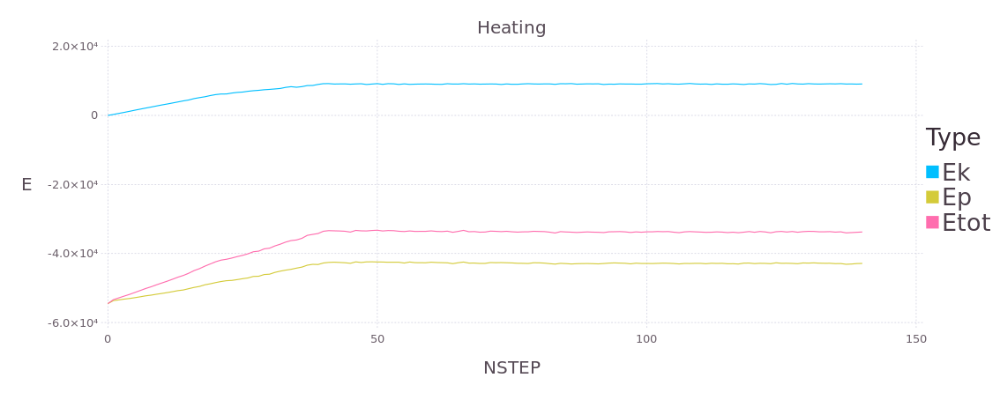

In [5]:
plot(df_apo_HEA_E, Geom.line, x="NSTEP", y="E", color="Type",
Guide.title("Heating"),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))

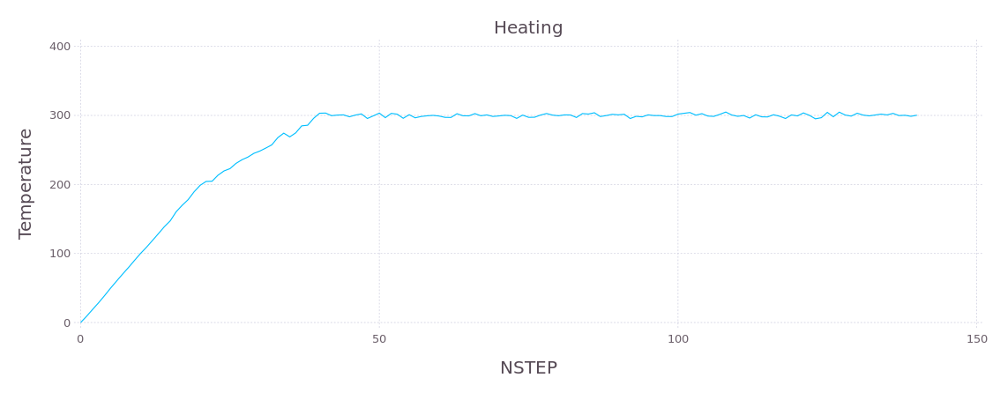

In [6]:
plot(df_apo_HEA_T, Geom.line, x="NSTEP", y="Temperature",
Guide.title("Heating"),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))

## equilibration

In [7]:
# Energies
dir_apo_equ="/home/german/labo/17/cph_obp/run/apo/mhe/e"
apo_equ_Ek = readdlm("$dir_apo_equ/outputs/ektot.dat");
apo_equ_Ep = readdlm("$dir_apo_equ/outputs/eptot.dat");
apo_equ_Etot = readdlm("$dir_apo_equ/outputs/etot.dat");

df_apo_EQU_E = DataFrame(E=[apo_equ_Ek[:, 2]; apo_equ_Ep[:, 2]; apo_equ_Etot[:, 2]],
NSTEP=[apo_equ_Ek[:, 1]; apo_equ_Ep[:, 1]; apo_equ_Etot[:, 1]];
Type=repeat(["Ek"; "Ep"; "Etot"], inner=[length(apo_equ_Ek[:, 1])]));

# Temperature
apo_equ_T = readdlm("$dir_apo_equ/outputs/temp.dat");
df_apo_EQU_T = DataFrame(Temperature=apo_equ_T[:, 2],
NSTEP=apo_equ_T[:, 1]);

# RMSD ntwx=500
apo_equ_rmsd = readdlm("$dir_apo_equ/rmsd_equ_apo");
df_apo_EQU_RMSD = DataFrame(RMSD=apo_equ_rmsd[:, 2], Frame=apo_equ_rmsd[:, 1]);

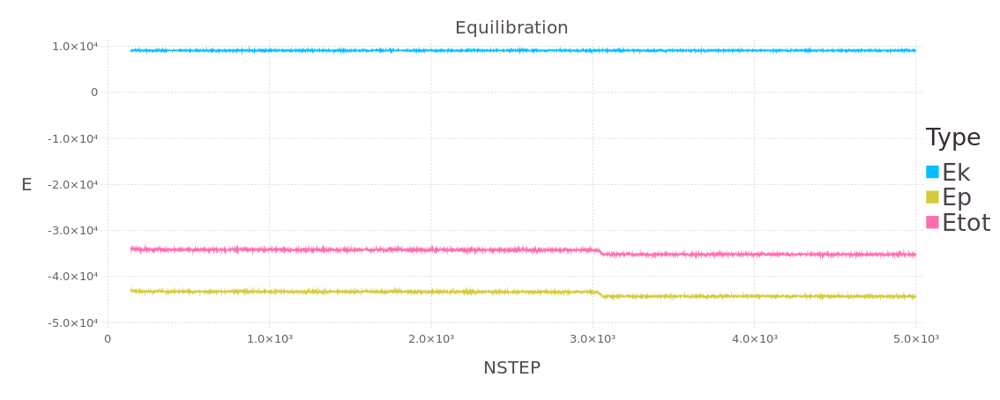

In [8]:
plot(df_apo_EQU_E, Geom.line, x="NSTEP", y="E", color="Type",
Guide.title("Equilibration"),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))

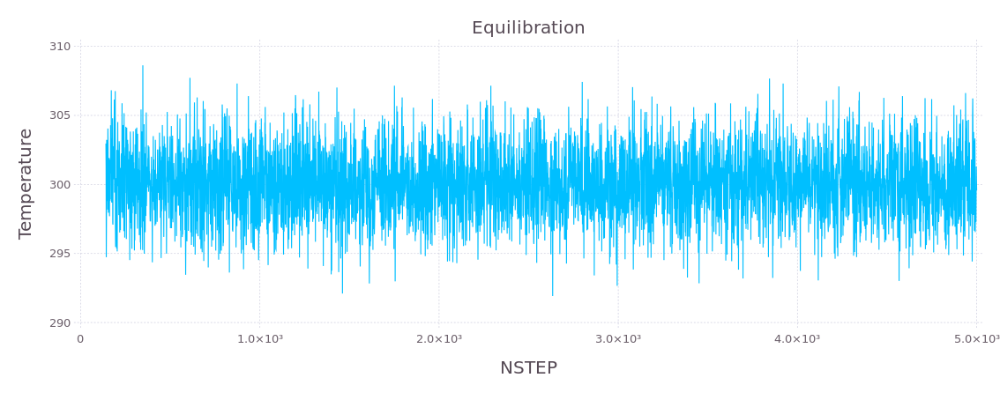

In [9]:
plot(df_apo_EQU_T, Geom.line, x="NSTEP", y="Temperature",
Guide.title("Equilibration"),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))

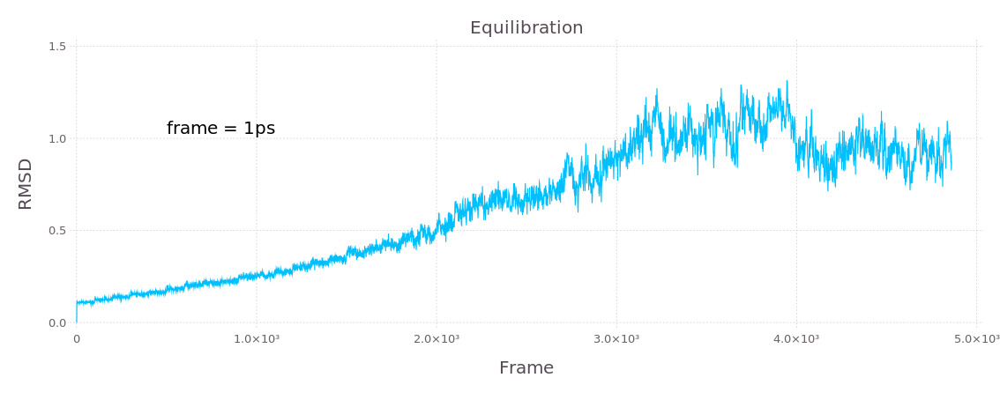

In [10]:
# Escribo c/ 1ps
plot(df_apo_EQU_RMSD, Geom.line, x="Frame", y="RMSD",
Guide.title("Equilibration"),
Guide.annotation(compose(compose(context(), text(500, 1.0, "frame = 1ps")), fontsize(15pt), fill("black"))),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))

### production

In [12]:
# Energies
dir_apo_pdt = "/home/german/labo/17/cph_obp/run/apo"
apo_pdt_Ek = readdlm("$dir_apo_pdt/data/outputs/ektot.dat");
apo_pdt_Ep = readdlm("$dir_apo_pdt/data/outputs/eptot.dat");
apo_pdt_Etot = readdlm("$dir_apo_pdt/data/outputs/etot.dat");
df_apo_PDT_E = DataFrame(E=[apo_pdt_Ek[:, 2]; apo_pdt_Ep[:, 2]; apo_pdt_Etot[:, 2]],
NSTEP=[apo_pdt_Ek[:, 1]; apo_pdt_Ep[:, 1]; apo_pdt_Etot[:, 1]];
Type=repeat(["Ek"; "Ep"; "Etot"], inner=[length(apo_pdt_Ek[:, 1])]));

# Temperature
apo_pdt_T = readdlm("$dir_apo_pdt/data/outputs/temp.dat");
df_apo_PDT_T = DataFrame(Temperature=apo_pdt_T[:, 2],
NSTEP=apo_pdt_T[:, 1]);

# RMSD 
apo_pdt_rmsd = readdlm("$dir_apo_pdt/data/rmsd_apo");
df_apo_PDT_RMSD = DataFrame(RMSD=apo_pdt_rmsd[:, 2], Frame=apo_pdt_rmsd[:, 1]);

# RMSF
apo_pdt_rmsf = readdlm("$dir_apo_pdt/data/rmsf_apo");
df_apo_PDT_RMSF = DataFrame(RMSF=apo_pdt_rmsf[:, 2], Frame=apo_pdt_rmsf[:, 1]);

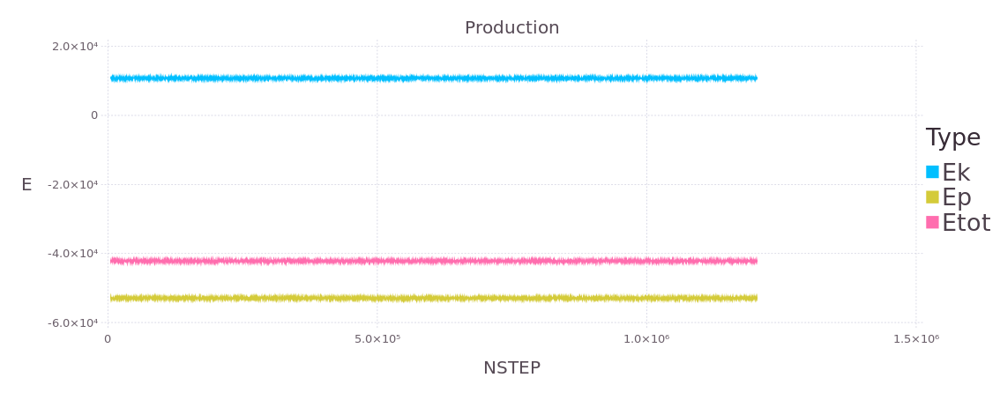

In [13]:
plot(df_apo_PDT_E, Geom.line, x="NSTEP", y="E", color="Type",
Guide.title("Production"),
Coords.xticks(ticks = ph_range),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
    key_title_font_size=20pt, key_label_font_size=20pt))                                                        

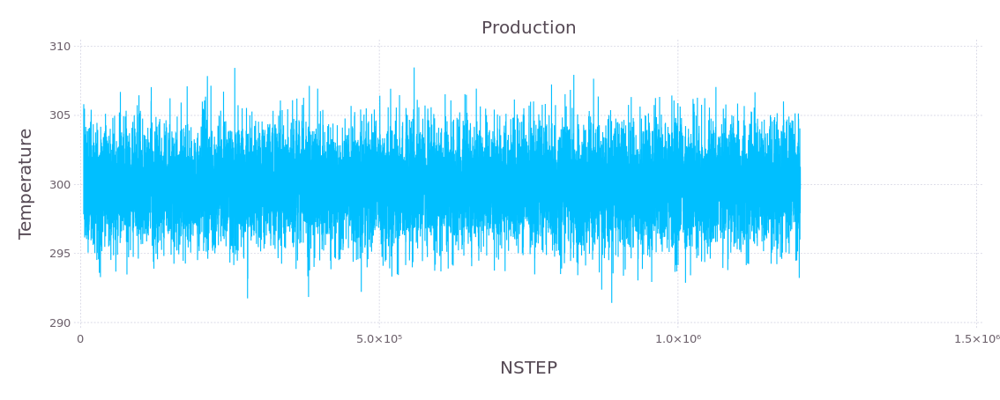

In [14]:
plot(df_apo_PDT_T, Geom.line, x="NSTEP", y="Temperature",
Guide.title("Production"),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))

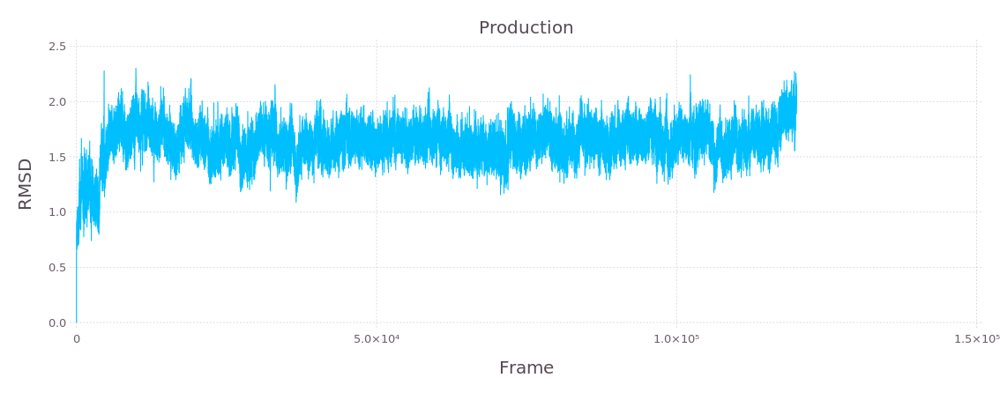

In [15]:
pdf_apo_PDT_RMSD = plot(df_apo_PDT_RMSD, Geom.line, x="Frame", y="RMSD",
Guide.title("Production"),
Guide.annotation(compose(compose(context(), text(70000, 3.5, "frame = 10ps")), fontsize(15pt), fill("black"))),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))

# ctv

## minimization

In [11]:
dir_ctv_min="/home/german/labo/17/cph_obp/run/ctv/mhe/m"
ctv_min_Etot = readdlm("$dir_ctv_min/outputs/Etot_min");
ctv_mmin_Etot = readdlm("$dir_ctv_min/outputs/Etot_mmin");
df_ctv_MIN_Etot = DataFrame(E=[ctv_min_Etot[:, 2]; ctv_mmin_Etot[:, 2]],
NSTEP=[ctv_min_Etot[:, 1]; ctv_mmin_Etot[:, 1] .+ 500.0 ]);

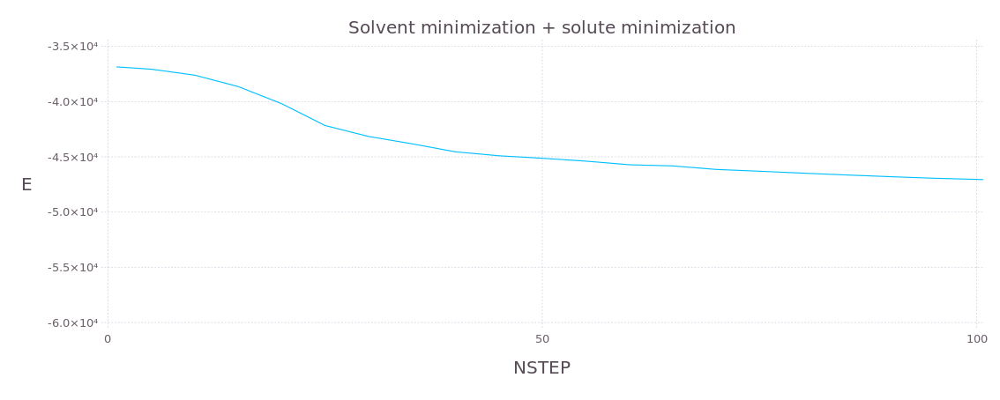

In [12]:
plot(df_ctv_MIN_Etot, Geom.line, x="NSTEP", y="E",
Coord.Cartesian(xmin=0, xmax=100),
Guide.title("Solvent minimization + solute minimization"),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt, key_title_font_size = 30pt))

## heat

In [13]:
# Energies
dir_ctv_hea="/home/german/labo/17/cph_obp/run/ctv/mhe/h"
ctv_hea_Ek = readdlm("$dir_ctv_hea/outputs/ektot.dat");
ctv_hea_Ep = readdlm("$dir_ctv_hea/outputs/eptot.dat");
ctv_hea_Etot = readdlm("$dir_ctv_hea/outputs/etot.dat");

df_ctv_HEA_E = DataFrame(E=[ctv_hea_Ek[:, 2]; ctv_hea_Ep[:, 2]; ctv_hea_Etot[:, 2]],
NSTEP=[ctv_hea_Ek[:, 1]; ctv_hea_Ep[:, 1]; ctv_hea_Etot[:, 1]];
Type=repeat(["Ek"; "Ep"; "Etot"], inner=[length(ctv_hea_Ek[:, 1])]));

# Temperature
ctv_hea_T = readdlm("$dir_ctv_hea/outputs/temp.dat");
df_ctv_HEA_T = DataFrame(Temperature=ctv_hea_T[:, 2],
NSTEP=ctv_hea_T[:, 1]);

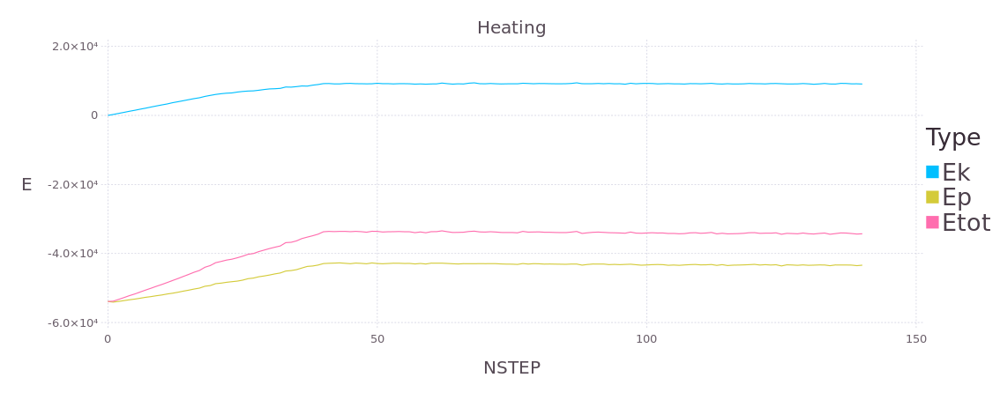

In [14]:
plot(df_ctv_HEA_E, Geom.line, x="NSTEP", y="E", color="Type",
Guide.title("Heating"),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))

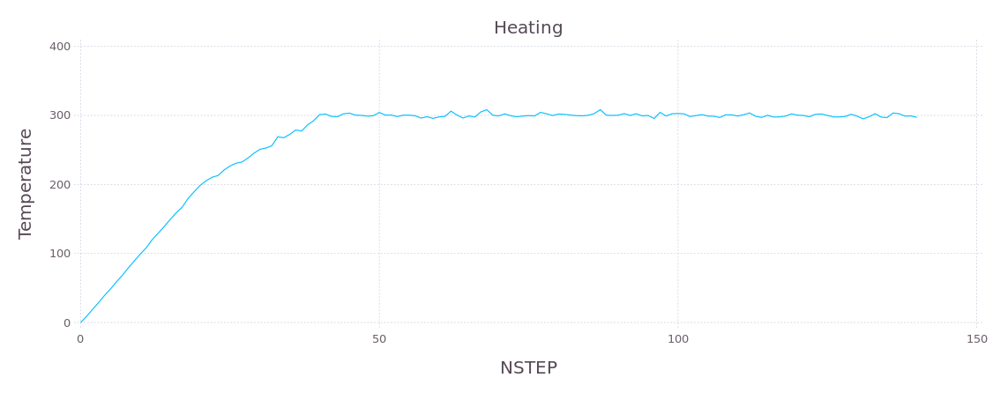

In [15]:
plot(df_ctv_HEA_T, Geom.line, x="NSTEP", y="Temperature",
Guide.title("Heating"),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))

## equilibration

In [16]:
# Energies
dir_ctv_equ="/home/german/labo/17/cph_obp/run/ctv/mhe/e"
ctv_equ_Ek = readdlm("$dir_ctv_equ/outputs/ektot.dat");
ctv_equ_Ep = readdlm("$dir_ctv_equ/outputs/eptot.dat");
ctv_equ_Etot = readdlm("$dir_ctv_equ/outputs/etot.dat");

df_ctv_EQU_E = DataFrame(E=[ctv_equ_Ek[:, 2]; ctv_equ_Ep[:, 2]; ctv_equ_Etot[:, 2]],
NSTEP=[ctv_equ_Ek[:, 1]; ctv_equ_Ep[:, 1]; ctv_equ_Etot[:, 1]];
Type=repeat(["Ek"; "Ep"; "Etot"], inner=[length(ctv_equ_Ek[:, 1])]));

# Temperature
ctv_equ_T = readdlm("$dir_ctv_equ/outputs/temp.dat");
df_ctv_EQU_T = DataFrame(Temperature=ctv_equ_T[:, 2],
NSTEP=ctv_equ_T[:, 1]);

# RMSD ntwx=500
ctv_equ_rmsd = readdlm("$dir_ctv_equ/rmsd_equ_ctv");
df_ctv_EQU_RMSD = DataFrame(RMSD=ctv_equ_rmsd[:, 2], Frame=ctv_equ_rmsd[:, 1]);

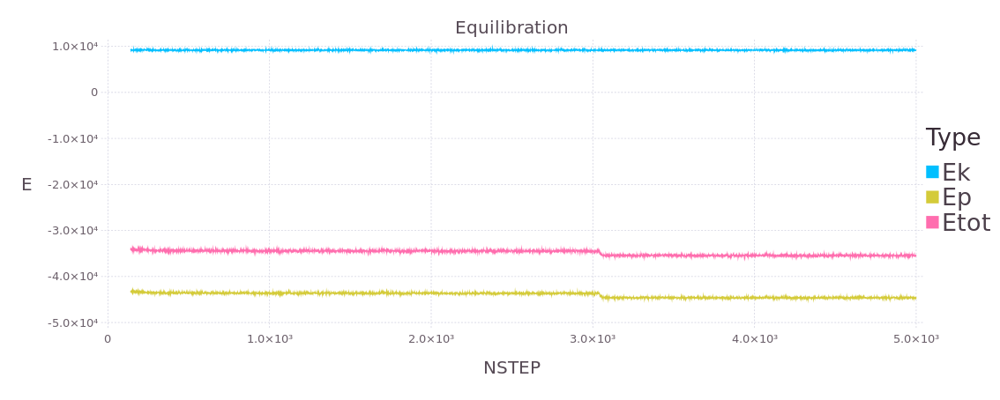

In [17]:
plot(df_ctv_EQU_E, Geom.line, x="NSTEP", y="E", color="Type",
Guide.title("Equilibration"),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))

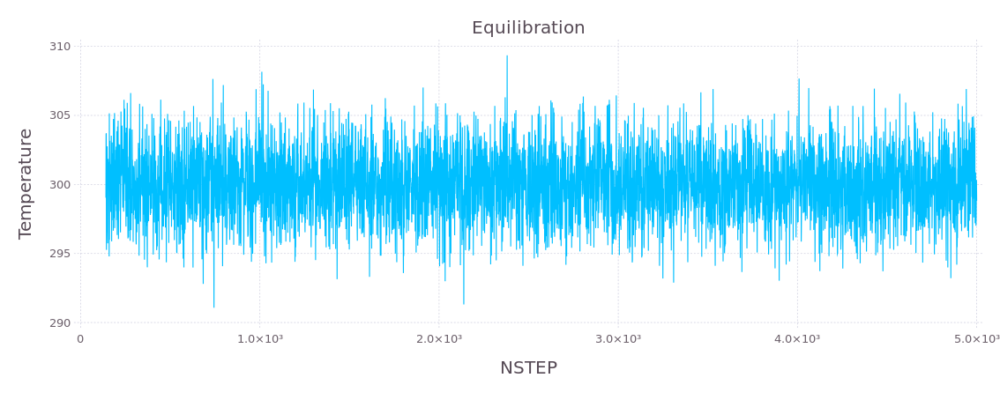

In [18]:
plot(df_ctv_EQU_T, Geom.line, x="NSTEP", y="Temperature",
Guide.title("Equilibration"),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))

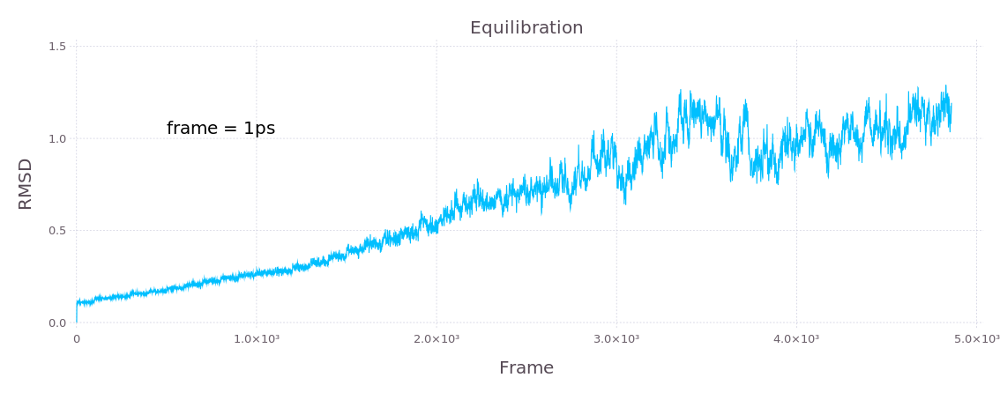

In [19]:
# Escribo c/ 1ps
plot(df_ctv_EQU_RMSD, Geom.line, x="Frame", y="RMSD",
Guide.title("Equilibration"),
Guide.annotation(compose(compose(context(), text(500, 1.0, "frame = 1ps")), fontsize(15pt), fill("black"))),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))

### production

In [25]:
# Energies
dir_ctv_pdt = "/home/german/labo/17/cph_obp/run/ctv"
ctv_pdt_Ek = readdlm("$dir_ctv_pdt/data/outputs/ektot.dat");
ctv_pdt_Ep = readdlm("$dir_ctv_pdt/data/outputs/eptot.dat");
ctv_pdt_Etot = readdlm("$dir_ctv_pdt/data/outputs/etot.dat");
df_ctv_PDT_E = DataFrame(E=[ctv_pdt_Ek[:, 2]; ctv_pdt_Ep[:, 2]; ctv_pdt_Etot[:, 2]],
NSTEP=[ctv_pdt_Ek[:, 1]; ctv_pdt_Ep[:, 1]; ctv_pdt_Etot[:, 1]];
Type=repeat(["Ek"; "Ep"; "Etot"], inner=[length(ctv_pdt_Ek[:, 1])]));

# Temperature
ctv_pdt_T = readdlm("$dir_ctv_pdt/data/outputs/temp.dat");
df_ctv_PDT_T = DataFrame(Temperature=ctv_pdt_T[:, 2],
NSTEP=ctv_pdt_T[:, 1]);

# RMSD 
ctv_pdt_rmsd = readdlm("$dir_ctv_pdt/data/rmsd_ctv");
df_ctv_PDT_RMSD = DataFrame(RMSD=ctv_pdt_rmsd[:, 2], Frame=ctv_pdt_rmsd[:, 1]);

# RMSF
ctv_pdt_rmsf = readdlm("$dir_ctv_pdt/data/rmsf_ctv");
df_ctv_PDT_RMSF = DataFrame(RMSF=ctv_pdt_rmsf[:, 2], Frame=ctv_pdt_rmsf[:, 1]);

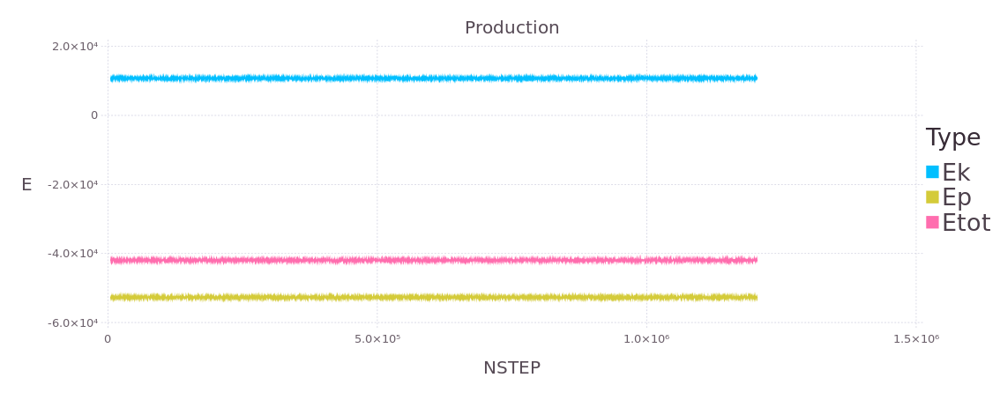

In [26]:
plot(df_ctv_PDT_E, Geom.line, x="NSTEP", y="E", color="Type",
Guide.title("Production"),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))                                                        

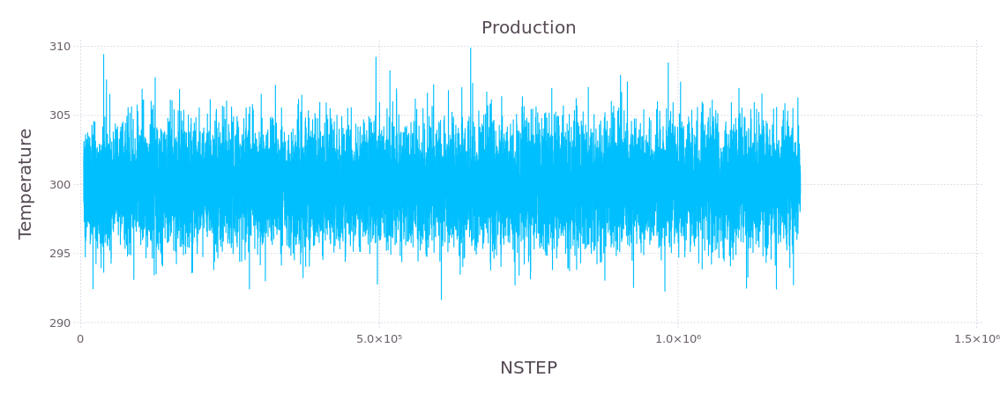

In [27]:
plot(df_ctv_PDT_T, Geom.line, x="NSTEP", y="Temperature",
Guide.title("Production"),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))

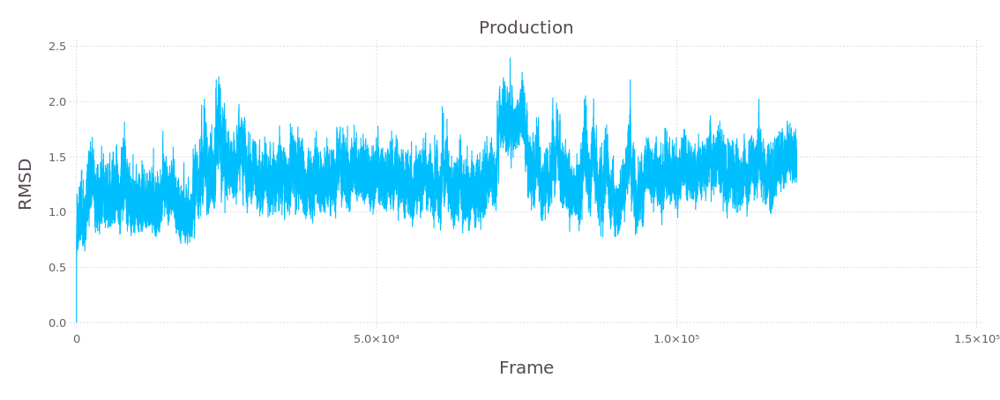

In [28]:
pdf_ctv_PDT_RMSD = plot(df_ctv_PDT_RMSD, Geom.line, x="Frame", y="RMSD",
Guide.title("Production"),
Guide.annotation(compose(compose(context(), text(70000, 3.5, "frame = 10ps")), fontsize(15pt), fill("black"))),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))

# eol

## minimization

In [20]:
dir_eol_min="/home/german/labo/17/cph_obp/run/eol/mhe/m"
eol_min_Etot = readdlm("$dir_eol_min/outputs/Etot_min");
eol_mmin_Etot = readdlm("$dir_eol_min/outputs/Etot_mmin");
df_eol_MIN_Etot = DataFrame(E=[eol_min_Etot[:, 2]; eol_mmin_Etot[:, 2]],
NSTEP=[eol_min_Etot[:, 1]; eol_mmin_Etot[:, 1] .+ 500.0 ]);

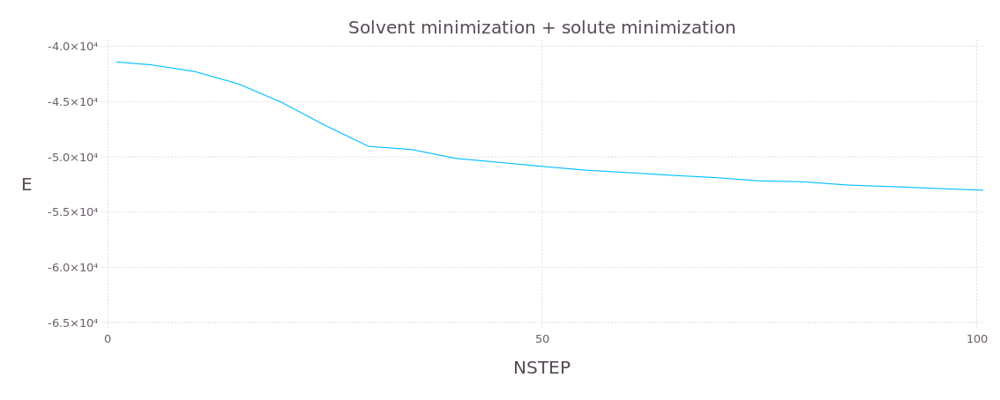

In [21]:
plot(df_eol_MIN_Etot, Geom.line, x="NSTEP", y="E",
Coord.Cartesian(xmin=0, xmax=100),
Guide.title("Solvent minimization + solute minimization"),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt, key_title_font_size = 30pt))

## heat

In [22]:
# Energies
dir_eol_hea="/home/german/labo/17/cph_obp/run/eol/mhe/h"
eol_hea_Ek = readdlm("$dir_eol_hea/outputs/ektot.dat");
eol_hea_Ep = readdlm("$dir_eol_hea/outputs/eptot.dat");
eol_hea_Etot = readdlm("$dir_eol_hea/outputs/etot.dat");

df_eol_HEA_E = DataFrame(E=[eol_hea_Ek[:, 2]; eol_hea_Ep[:, 2]; eol_hea_Etot[:, 2]],
NSTEP=[eol_hea_Ek[:, 1]; eol_hea_Ep[:, 1]; eol_hea_Etot[:, 1]];
Type=repeat(["Ek"; "Ep"; "Etot"], inner=[length(eol_hea_Ek[:, 1])]));

# Temperature
eol_hea_T = readdlm("$dir_eol_hea/outputs/temp.dat");
df_eol_HEA_T = DataFrame(Temperature=eol_hea_T[:, 2],
NSTEP=eol_hea_T[:, 1]);

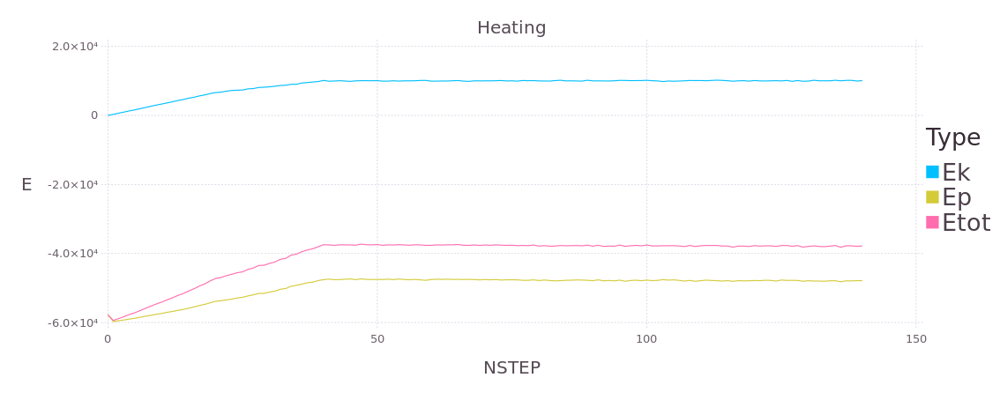

In [23]:
plot(df_eol_HEA_E, Geom.line, x="NSTEP", y="E", color="Type",
Guide.title("Heating"),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))

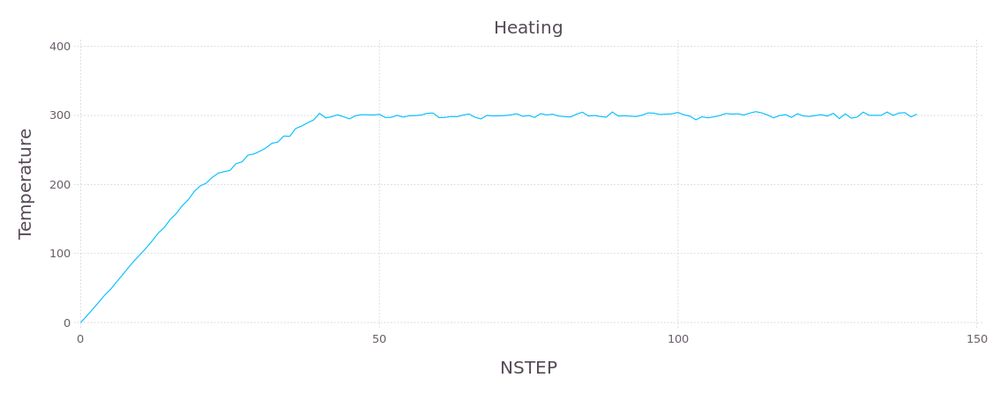

In [24]:
plot(df_eol_HEA_T, Geom.line, x="NSTEP", y="Temperature",
Guide.title("Heating"),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))

## equilibration

In [25]:
# Energies
dir_eol_equ="/home/german/labo/17/cph_obp/run/eol/mhe/e"
eol_equ_Ek = readdlm("$dir_eol_equ/outputs/ektot.dat");
eol_equ_Ep = readdlm("$dir_eol_equ/outputs/eptot.dat");
eol_equ_Etot = readdlm("$dir_eol_equ/outputs/etot.dat");

df_eol_EQU_E = DataFrame(E=[eol_equ_Ek[:, 2]; eol_equ_Ep[:, 2]; eol_equ_Etot[:, 2]],
NSTEP=[eol_equ_Ek[:, 1]; eol_equ_Ep[:, 1]; eol_equ_Etot[:, 1]];
Type=repeat(["Ek"; "Ep"; "Etot"], inner=[length(eol_equ_Ek[:, 1])]));

# Temperature
eol_equ_T = readdlm("$dir_eol_equ/outputs/temp.dat");
df_eol_EQU_T = DataFrame(Temperature=eol_equ_T[:, 2],
NSTEP=eol_equ_T[:, 1]);

# RMSD ntwx=500
eol_equ_rmsd = readdlm("$dir_eol_equ/rmsd_equ_eol");
df_eol_EQU_RMSD = DataFrame(RMSD=eol_equ_rmsd[:, 2], Frame=eol_equ_rmsd[:, 1]);

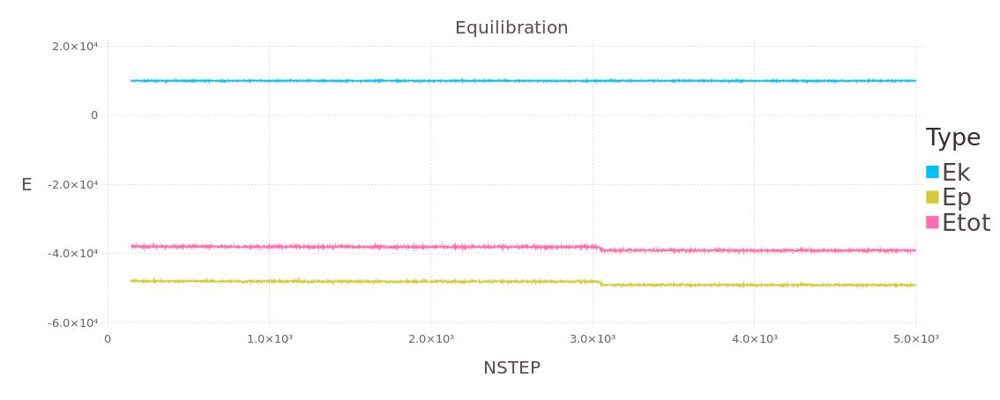

In [26]:
plot(df_eol_EQU_E, Geom.line, x="NSTEP", y="E", color="Type",
Guide.title("Equilibration"),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))

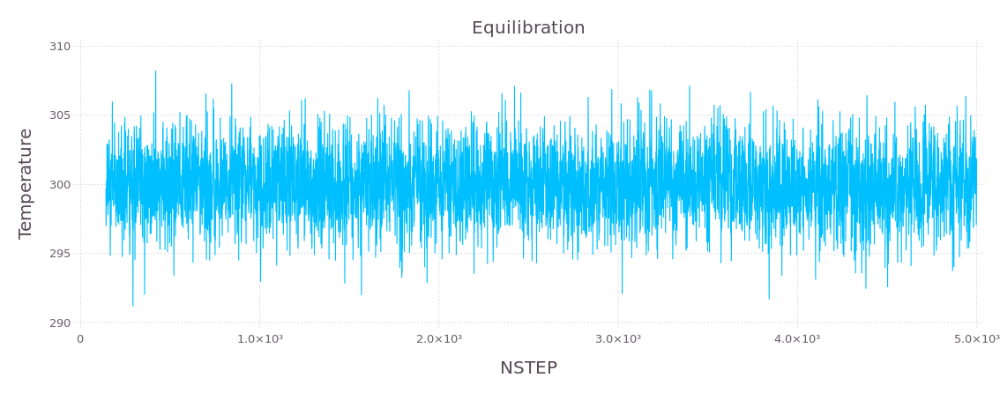

In [27]:
plot(df_eol_EQU_T, Geom.line, x="NSTEP", y="Temperature",
Guide.title("Equilibration"),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))

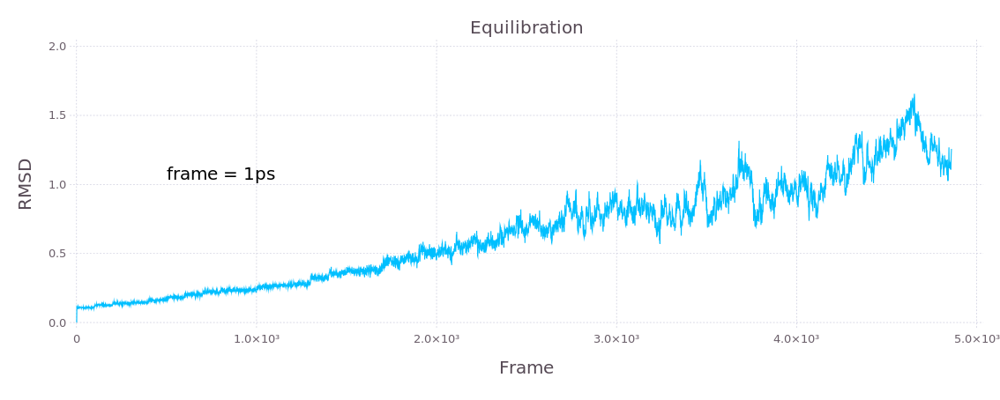

In [28]:
# Escribo c/ 1ps
plot(df_eol_EQU_RMSD, Geom.line, x="Frame", y="RMSD",
Guide.title("Equilibration"),
Guide.annotation(compose(compose(context(), text(500, 1.0, "frame = 1ps")), fontsize(15pt), fill("black"))),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))

### production

In [38]:
# Energies
dir_eol_pdt = "/home/german/labo/17/cph_obp/run/eol"
eol_pdt_Ek = readdlm("$dir_eol_pdt/data/outputs/ektot.dat");
eol_pdt_Ep = readdlm("$dir_eol_pdt/data/outputs/eptot.dat");
eol_pdt_Etot = readdlm("$dir_eol_pdt/data/outputs/etot.dat");
df_eol_PDT_E = DataFrame(E=[eol_pdt_Ek[:, 2]; eol_pdt_Ep[:, 2]; eol_pdt_Etot[:, 2]],
NSTEP=[eol_pdt_Ek[:, 1]; eol_pdt_Ep[:, 1]; eol_pdt_Etot[:, 1]];
Type=repeat(["Ek"; "Ep"; "Etot"], inner=[length(eol_pdt_Ek[:, 1])]));

# Temperature
eol_pdt_T = readdlm("$dir_eol_pdt/data/outputs/temp.dat");
df_eol_PDT_T = DataFrame(Temperature=eol_pdt_T[:, 2],
NSTEP=eol_pdt_T[:, 1]);

# RMSD 
eol_pdt_rmsd = readdlm("$dir_eol_pdt/data/rmsd_eol");
df_eol_PDT_RMSD = DataFrame(RMSD=eol_pdt_rmsd[:, 2], Frame=eol_pdt_rmsd[:, 1]);

# RMSF
eol_pdt_rmsf = readdlm("$dir_eol_pdt/data/rmsf_eol");
df_eol_PDT_RMSF = DataFrame(RMSF=eol_pdt_rmsf[:, 2], Frame=eol_pdt_rmsf[:, 1]);

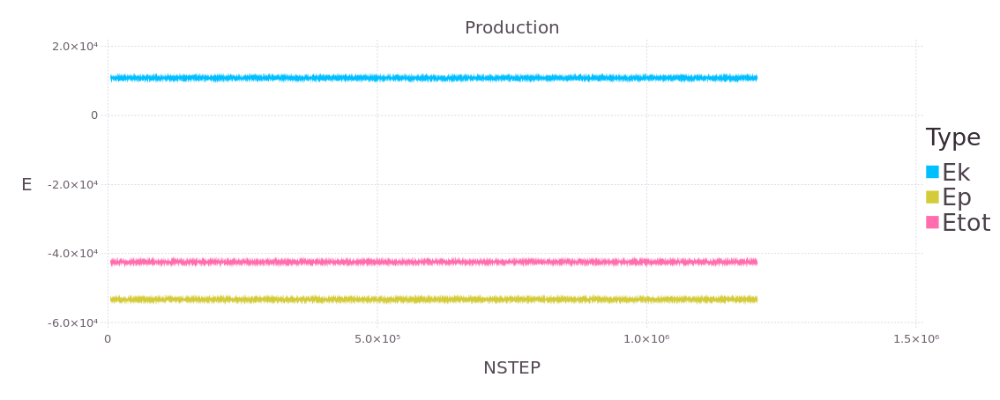

In [39]:
plot(df_eol_PDT_E, Geom.line, x="NSTEP", y="E", color="Type",
Guide.title("Production"),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))                                                        

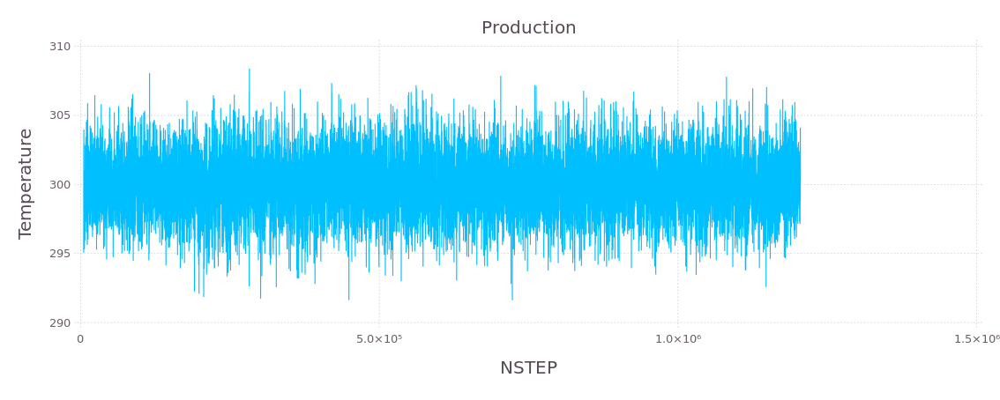

In [40]:
plot(df_eol_PDT_T, Geom.line, x="NSTEP", y="Temperature",
Guide.title("Production"),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))

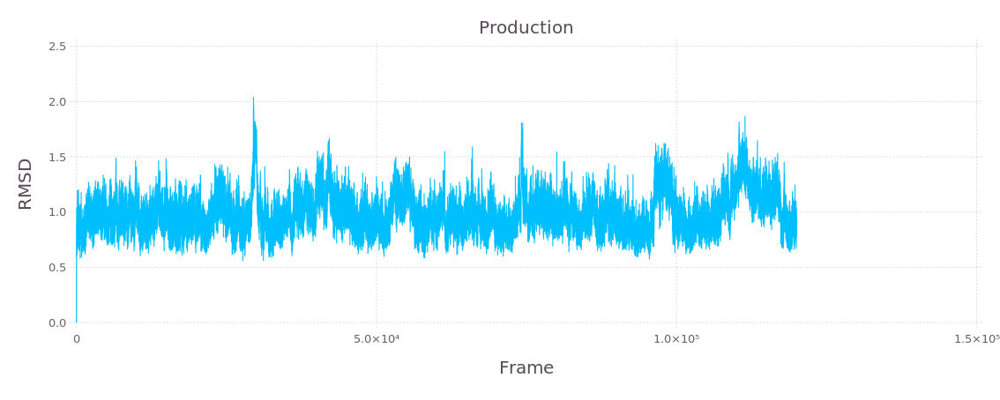

In [41]:
pdf_eol_PDT_RMSD = plot(df_eol_PDT_RMSD, Geom.line, x="Frame", y="RMSD",
Guide.title("Production"),
Guide.annotation(compose(compose(context(), text(70000, 3.5, "frame = 10ps")), fontsize(15pt), fill("black"))),
Theme(minor_label_font_size = 10pt, major_label_font_size = 15pt,
key_title_font_size=20pt, key_label_font_size=20pt))